<a href="https://colab.research.google.com/github/viniciusguirra/motordepesquisa/blob/main/alex_poatan_Motor_de_Pesquisa.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

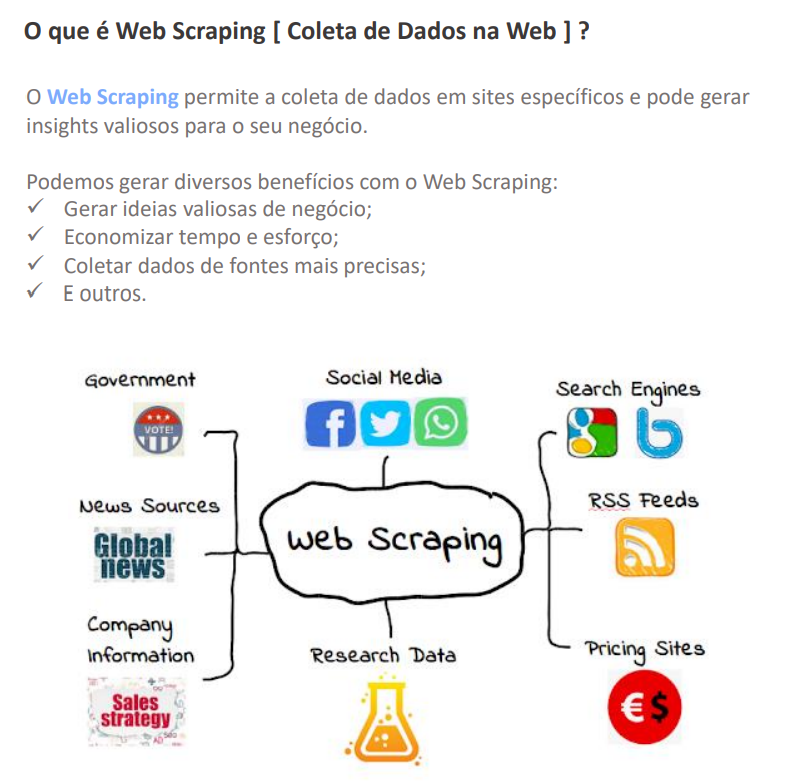

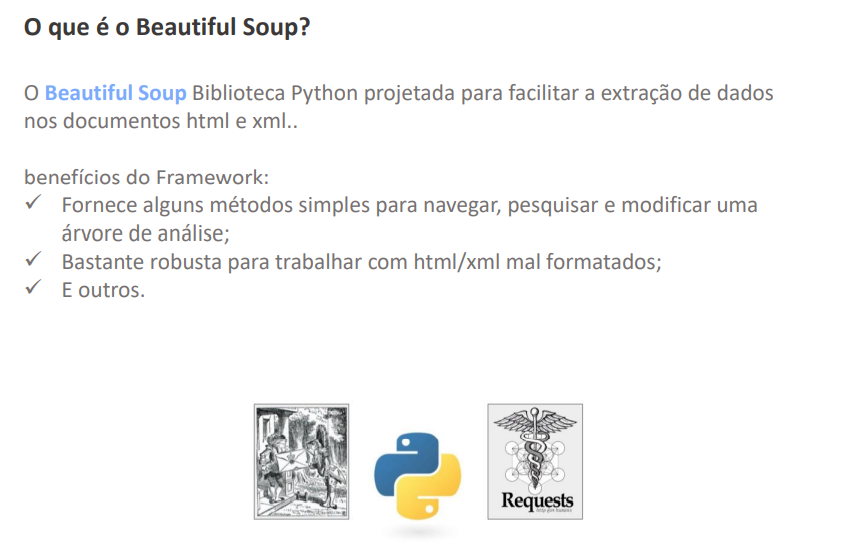

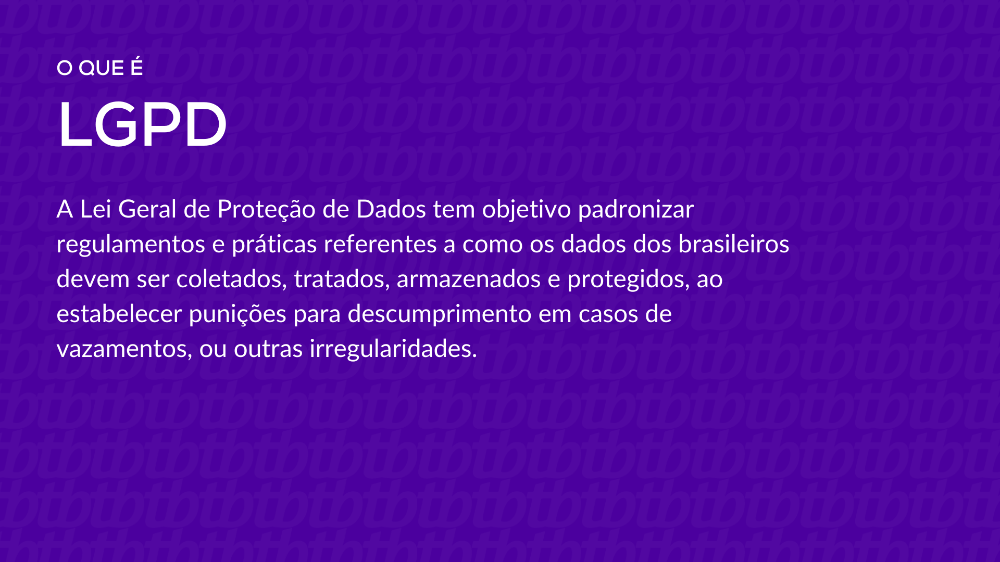

In [1]:
# Instala o pacote
!pip install WordCloud

In [2]:
# Libs
import numpy as np
import pandas as pd

# Pacote para trabalhar com dados HTML e XML
from bs4 import BeautifulSoup

# Pacote para requisições HTTP
import requests

# Pacote para nuvem de palavras
from wordcloud import WordCloud

# Análises graficas
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Avisos
import warnings
warnings.filterwarnings('ignore')

In [19]:
# Link do site
Site = 'https://news.google.com/search?for=alex%20poatan&hl=pt-BR&gl=BR&ceid=BR%3Apt-419'

# Requisição
Pagina = requests.get( Site )

type( Pagina )

requests.models.Response

In [20]:
# Lendo os dados no BS
Coleta = BeautifulSoup( Pagina.text, 'html.parser' )

In [21]:
# Titulo
Coleta.title.string

'Google Notícias - Pesquisar'

In [22]:
Coleta.title.name

'title'

In [16]:
# Pesquisa uma TAG na página
Coleta.find( class_='cp7Yvc' ).string

'Poatan nocauteia Prochazka e conquista cinturão do UFC'

In [23]:
Coleta.find( class_='cp7Yvc' ).name

'div'

In [24]:
len( Coleta.find_all('a') )

414

In [25]:
# Função
def Buscar_Empresas(ticket):

  # Criando um URL dinâmica
  Url = f'https://news.google.com/search?q={ticket}&hl=pt-BR&gl=BR&ceid=BR%3Apt-419'

  # Respostas pela requests
  Resposta = requests.get( Url )

  # Transformar em texto a resposta
  Codigo_HTML = Resposta.text

  # Converter
  Objeto_Soup = BeautifulSoup( Codigo_HTML, 'html.parser')

  return Objeto_Soup

In [26]:
# Buscando os dados
Dados = Buscar_Empresas('alex poatan')

len( Dados )

4

In [27]:
# Buscar os titulos H3
Elementos = Dados.find_all('h3')

len( Elementos )

101

In [28]:
# Buscar os textos
Noticias = [ Texto.get_text() for Texto in Elementos ]

print('Noticias localizadas')
len( Noticias )

Noticias localizadas


101

In [29]:
print('***' * 7 )
print('Noticias localizadas')
print('***' * 7 )

for Numero, Loop in enumerate( Noticias[0:5] ):
  print('--' * 10 )
  print( Numero, '-', Loop )

*********************
Noticias localizadas
*********************
--------------------
0 - UFC 295: Alex Poatan fatura R$ 245 mil por 'Performance da Noite'
--------------------
1 - UFC 295: Poatan nocauteia Prochazka e conquista segundo cinturão
--------------------
2 - UFC: Alex Poatan defende árbitro por decisão 'polêmica' em luta com Prochazka
--------------------
3 - Poatan consegue nocaute brutal, é campeão do meio-pesado do UFC e faz história - ESPN
--------------------
4 - Nocauteado por Alex Poatan, tcheco admite revés no UFC 295: 'Estava apagado' | | O Dia


## NLP - Stops Words

In [30]:
# Remover Stops Words

# Importar o NLTK
import nltk
from nltk.corpus import stopwords

# Download
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [31]:
# Palavras stopswords portugues
Lista_Palavras = stopwords.words('portuguese')

len( Lista_Palavras )

207

In [32]:
type( Lista_Palavras )

list

In [33]:
# Inclui palavras no Stop Words
Lista_Palavras.append('-')
Lista_Palavras[-1]

'-'

In [35]:
#Adicionando várias palavras de uma só vez
Lista_Palavras.extend(['sobre', 'contra', 'após', '...','diz'])

In [36]:
Lista_Palavras[0:5]

['a', 'à', 'ao', 'aos', 'aquela']

In [37]:
# Retirar as Stops Words

# String para junta todo o texto
Concatenar = ''
Lista_Palavras_Retiradas = []

# Loop nas Noticias
for Loop in Noticias[0:]:

  # Quebrar a frase em uma lista
  Quebra = Loop.split()

  # Rodar cada palavra da lista
  for Palavra in Quebra:

    # Verifique se a palavra não está na lista de stop words
    if Palavra.lower() not in Lista_Palavras:
      Concatenar = Concatenar + ' ' + Palavra.lower()

    else:
      Lista_Palavras_Retiradas.append( Palavra.lower() )

print( 'Total de palavras retiradas:', len(Lista_Palavras_Retiradas) )

Total de palavras retiradas: 393


In [38]:
Concatenar

' ufc 295: alex poatan fatura r$ 245 mil \'performance noite\' ufc 295: poatan nocauteia prochazka conquista segundo cinturão ufc: alex poatan defende árbitro decisão \'polêmica\' luta prochazka poatan consegue nocaute brutal, campeão meio-pesado ufc faz história espn nocauteado alex poatan, tcheco admite revés ufc 295: \'estava apagado\' | | dia brasil pode receber próxima luta alex poatan ufc, revela dana white | super lutas bernardo, alex poatan conquista cinturão | diário grande abc notícias informações alex poatan revela chance subir peso-pesado busca terceiro cinturão ufc alex poatan conquista título meio-pesado ufc combate histórico corintiano alex poatan campeão peso meio pesado ufc! ufc 295: brasileiro fatura bônus r$ 245 mil \'performance noite\' ufc 295 melhores momentos | prochazka x pereira 11/11/2023 | band alex poatan sincero interrupção polêmica árbitro ufc 295 espn ufc: alex poatan defende árbitro decisão \'polêmica\' luta prochazka lance! alex poatan explica desafio a

## Contagem de Palavras

In [39]:
# Contagem de palavras
from collections import Counter

# Dividir a string Concatenar em palavras
palavras = Concatenar.split()

# Contagem de palavrasa
contagem_palavras = Counter(palavras)

# Exibir as 5 palavras mais comuns
print(
    contagem_palavras.most_common(7)
)

[('poatan', 89), ('alex', 74), ('espn', 47), ('ufc', 44), ('adesanya', 27), ('luta', 15), ('cinturão', 10)]


In [41]:
# Cria o Data Frame
Anl_Palavras = pd.DataFrame( contagem_palavras, index=[0] ).transpose().reset_index()

# Renomea as colunas
Anl_Palavras.columns = ['Palavra', 'Quantidade']

# Ordenar
Anl_Palavras.sort_values( by='Quantidade', ascending=False, inplace=True )

Anl_Palavras

,Palavra,Quantidade
3,poatan,89
2,alex,74
28,espn,47
0,ufc,44
82,adesanya,27
...,...,...
174,reprova,1
173,silva,1
172,anderson,1
171,evitar,1


In [43]:
# Representação
Anl_Palavras['%_Representação'] = Anl_Palavras.Quantidade.cumsum() / Anl_Palavras.Quantidade.sum() * 100
Anl_Palavras

,Palavra,Quantidade,%_Representação
3,poatan,89,9.899889
2,alex,74,18.131257
28,espn,47,23.359288
0,ufc,44,28.253615
82,adesanya,27,31.256952
...,...,...,...
174,reprova,1,99.555061
173,silva,1,99.666296
172,anderson,1,99.777531
171,evitar,1,99.888765


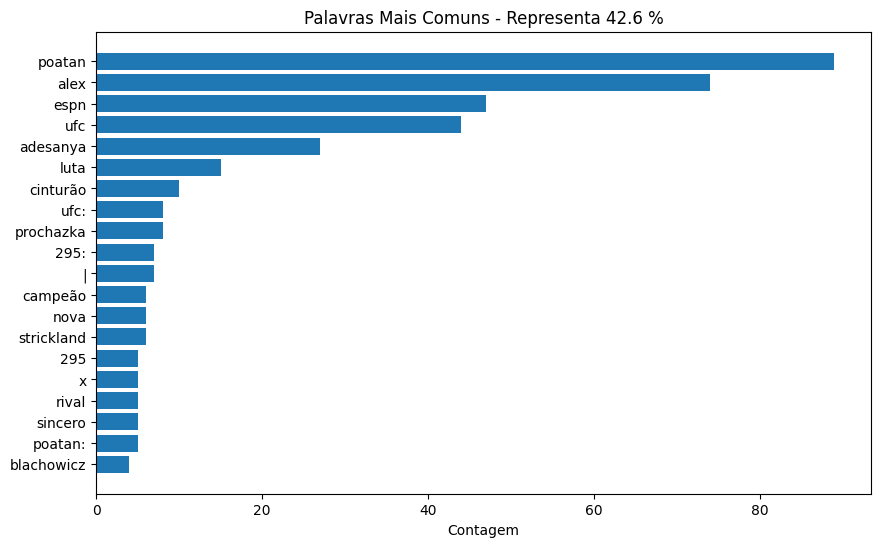

In [44]:
# 20 Palavras mais citdads
Filtro_Top_20 = Anl_Palavras.head(20)
Titutlo_Max = round( Filtro_Top_20['%_Representação'].max(), 2 )

# Plot
plt.figure( figsize=(10, 6) )
plt.barh( Filtro_Top_20.Palavra, Filtro_Top_20.Quantidade )
plt.xlabel('Contagem')
plt.title(f'Palavras Mais Comuns - Representa { Titutlo_Max } %')
plt.gca().invert_yaxis()  # Inverter a ordem das palavras mais comuns
plt.show()

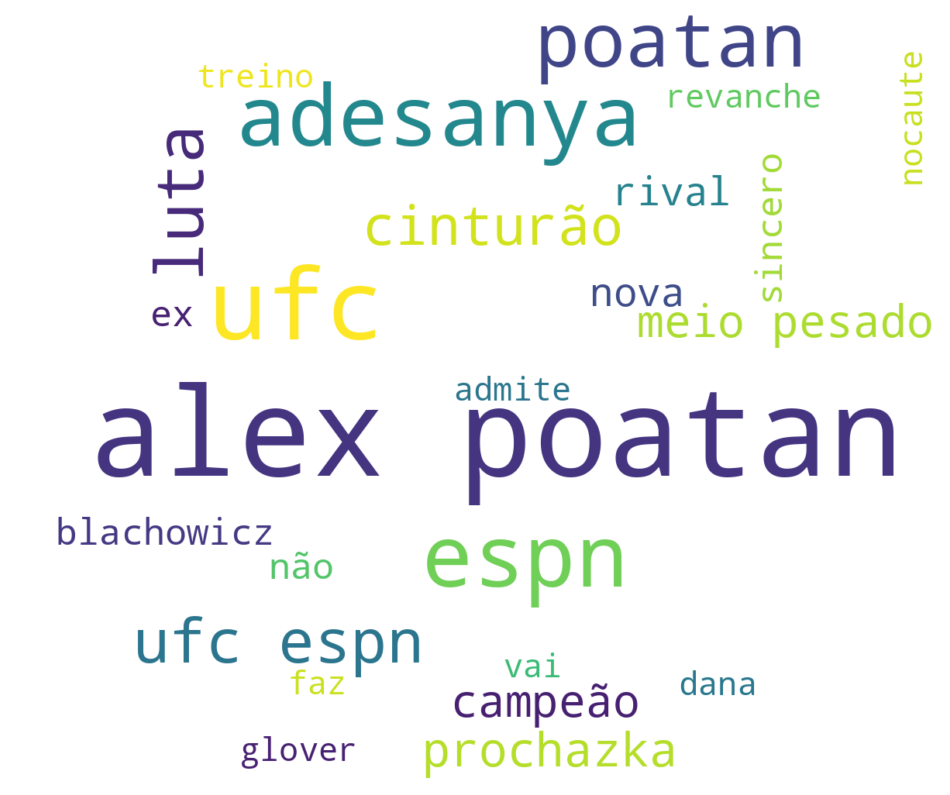

In [45]:
## Nuvem de Palavras
Nuvem_Palavras = WordCloud(
    # Tamanho
    width=1200,
    height=1000,
    # Max de palavras
    max_words=25,
    # Tamanho min de palavras
    min_font_size=8,
    # fundo
    background_color='white',
    stopwords=['após', 'mês', 'ter']
).generate( Concatenar )

# Plot

# Crio a Figura
Figura, Eixo = plt.subplots( figsize=(12, 18) )
# PLOT das palabras
Eixo.imshow( Nuvem_Palavras, interpolation='bilinear' )
# Retiro os eixos
Eixo.set_axis_off()

# Exportando o gráfico
plt.savefig('Analise_Nuvem_Palavras.jpg', format='jpg')

In [46]:
# Dados do cabeçalho e valores
cabecalho = ['Noticia']
valores = Noticias[0:10]

LinhaBranca = 'white'
LinhaAzul = 'paleturquoise'

# Criação da tabela
tabela = go.Figure(
    data=[
        go.Table(
            header=dict( values=cabecalho, fill_color='RoyalBlue', font_color='white', height=40, align='left', font_size=10 ),
            cells=dict( values=[valores], height=30, align='left', line_color='#f5f5f5', font_size=10,
                       fill_color=[[LinhaBranca, LinhaAzul, LinhaBranca, LinhaAzul,LinhaBranca, LinhaAzul,LinhaBranca, LinhaAzul,LinhaBranca, LinhaAzul ]] )
        )
    ]
)

# Configurações de layout da tabela
tabela.update_layout(
    title='Principais Noticías',
    width=1000,
    height=700
)

# Exibindo a tabela
tabela.show()

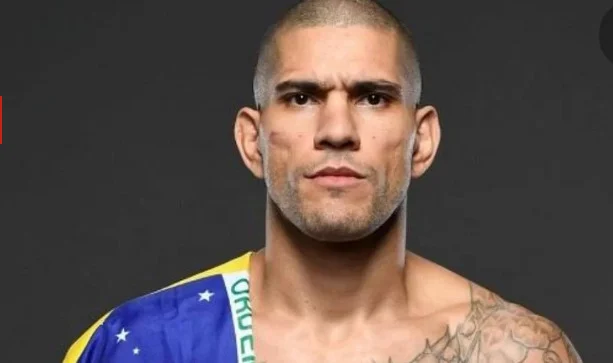

In [47]:
from PIL import Image
alexpoatan = Image.open('/content/Alex-Poatan.webp')
alexpoatan

In [48]:
# Criar a Figura
Figura = make_subplots(
    rows=3,
    cols=1,
    specs=[
        [{'type':'table'}],
        [{'type':'bar'}],
        [{}]
    ],
    vertical_spacing=0.075,
    shared_xaxes=True,
    subplot_titles=('', 'Palavras mais frequentes', 'Nuvem de Palavras')
)

# Layout e Dimensão
Figura.update_layout(
    width=1000, height=1200, title_text='<b>Data Analytics</b> <br>Motor de Pesquisa'
)

# Adicionando o icone da alexpoatan
Figura.add_layout_image(
    dict( source=alexpoatan, x=1, y=1.02, sizex=0.07,
         sizey=0.07, xanchor='right', yanchor='bottom')
)

# Dados do cabeçalho e valores
cabecalho = ['Web Scraping de busca de Notícias | Alex Poatan']
valores = Noticias[0:5]

LinhaBranca = 'white'
LinhaAzul = 'paleturquoise'

Figura.add_trace(
     go.Table(
            header=dict( values=cabecalho, fill_color='RoyalBlue', font_color='white', height=40, align='left', font_size=16 ),
            cells=dict( values=[valores], height=50, align='left', line_color='#f5f5f5', font_size=14,
                       fill_color=[[LinhaBranca, LinhaAzul,LinhaBranca, LinhaAzul,LinhaBranca, LinhaAzul,LinhaBranca, LinhaAzul,LinhaBranca, LinhaAzul ]] )
        ),
    row=1, col=1
)

# Adicionado um gráfico na 2º Posição
Figura.add_trace(
    go.Bar(
        x=Filtro_Top_20.Palavra,
        y=Filtro_Top_20.Quantidade,
        textposition="outside",
        texttemplate="%{x}",
        marker_color='royalblue',
    ),
    row=2, col=1
)

Anl_Nuvem = Image.open('Analise_Nuvem_Palavras.jpg')

# Adicionado um gráfico na 2º Posição
Figura.add_trace(
    go.Image(
        z=Anl_Nuvem,
        x0=0
    ),
    row=3, col=1
)

# Rodapes
Figura.add_annotation(
    showarrow=False,
    text='Análise feita por Vinícius Guirra | DataViking ',
    font=dict(size=12),
    xref='x domain',
    x=1,
    yref='y domain',
    y=-1.4
)

Figura.add_annotation(
    showarrow=False,
    text='By: @guirracruz | @data.verso',
    font=dict(size=12),
    xref='x domain',
    x=0,
    yref='y domain',
    y=-1.4
)

Figura

In [ ]:
'''
A análise das notícias revelou insights interessantes sobre a frequência das palavras.
No total, foram observadas 101 notícias. As palavras ‘poatan’, ‘alex’, ‘espn’, ‘ufc’ e
‘adesanya’ foram as mais frequentes. É interessante notar que o sobrenome ‘Poatan’
apareceu com mais frequência do que o nome ‘Alex’, destacando a força e o impacto do
sobrenome ‘Poatan’ no conjunto de dados. Além disso, as 20 palavras mais comuns representam
42,6% do total, o que indica uma concentração significativa em torno dessas palavras-chave.
Este estudo demonstra o poder e a flexibilidade das ferramentas de análise de dados modernas,
bem como a importância de uma análise cuidadosa das palavras-chave ao examinar um conjunto de dados de notícias
'''